## CNN Model for Fruit and Vegetable Classification

### Importing Libraries

In [26]:
# inital imports
import os
import shutil

# for preprocessing
import glob 
from skimage import io 
from matplotlib import pyplot as plt
from tensorflow.keras.preprocessing.image import ImageDataGenerator
import pandas as pd
import numpy as np
import tensorflow as tf

# hide tensorflow warning
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '2'

# for splitting
from sklearn.model_selection import train_test_split

# for modeling
from tensorflow.keras.models import Sequential
from tensorflow.keras import layers
from keras.layers import Dense, Flatten, Dropout, Conv2D, MaxPooling2D
from tensorflow.keras.optimizers import RMSprop, Adam, SGD


In [ ]:
# pip install tensorflow --upgrade # upgrade tensorflow

### Setup Enviroment

In [ ]:
# Clearning the enviroment
os.remove('fresh-and-stale-images-of-fruits-and-vegetables.zip')
os.remove('ImageLabels.txt')
shutil.rmtree('fruitsandvegetables')

#### a) Import Dataset from Kaggle

In [ ]:
os.environ["KAGGLE_USERNAME"] = "paihwai"
os.environ["KAGGLE_KEY"] = "59919fd8d350a08f43adeb0041ead3f9"

In [ ]:
!pip install kaggle

In [ ]:
!kaggle datasets download raghavrpotdar/fresh-and-stale-images-of-fruits-and-vegetables

In [ ]:
!unzip fresh-and-stale-images-of-fruits-and-vegetables.zip

#### b) Move Imported to New Directory

In [ ]:
os.mkdir('fruitsandvegetables') # make a new folder

In [ ]:
# move all the image subfolders into the new folder 
directory = 'fruitsandvegetables'
for i in os.listdir():
    if (i.startswith("fresh") or i.startswith("stale")) and (i.endswith(".zip") == False):
        shutil.move(i, directory)

### Inspecting the Data

In [2]:
# getting the list
print(len(os.listdir('fruitsandvegetables')))  # classes

12


In [3]:
print(len(os.listdir('./fruitsandvegetables/fresh_apple')))
print(len(os.listdir('./fruitsandvegetables/stale_apple')))

1693
2342


In [4]:
for filenames in os.listdir('fruitsandvegetables'):
    print(f"length of {filenames}: {len(os.listdir(f'./fruitsandvegetables/{filenames}'))}")

length of stale_bitter_gourd: 357
length of fresh_bitter_gourd: 327
length of fresh_tomato: 981
length of stale_capsicum: 901
length of fresh_capsicum: 990
length of stale_tomato: 982
length of stale_apple: 2342
length of stale_orange: 1595
length of fresh_banana: 1581
length of fresh_apple: 1693
length of fresh_orange: 1466
length of stale_banana: 1467


When inspecting the lengths, I can determine to apply some data augmentations. For example, The model would be better at classifying apples over bitter gourd due to the difference in their lengths. 

In [5]:
# set directory and labels
dir_path = 'fruitsandvegetables'
labels = []
for i in os.listdir(dir_path):
    labels.append(i)
print(labels)

['stale_bitter_gourd', 'fresh_bitter_gourd', 'fresh_tomato', 'stale_capsicum', 'fresh_capsicum', 'stale_tomato', 'stale_apple', 'stale_orange', 'fresh_banana', 'fresh_apple', 'fresh_orange', 'stale_banana']


In [6]:
# apply glob module to retrieve files/pathnames  
fresh_apple_path = os.path.join(dir_path, labels[9], '*')
fresh_apple_path = glob.glob(fresh_apple_path)

(398, 442, 3)

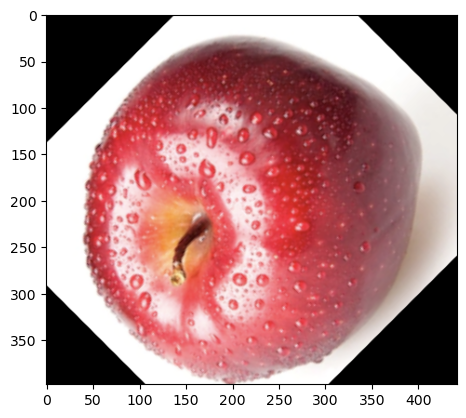

In [7]:
# accessing an image file from the dataset classes
image = io.imread(fresh_apple_path[100])  

# plotting the original image
i, (im1) = plt.subplots(1)
i.set_figwidth(15)
im1.imshow(image)

type(image)
image.shape # we get the dimension of the image

We can see here from randomly printing an image from our original dataset that the random rotations is already done.
But so far we do not know if any other augmentation is needed so the first trial will be without additional data augmentations. 

### Converting image data to binary 

In [ ]:
# !pip install opencv-python # install open cv

In [8]:
import cv2

In [10]:
# converting image data into array and assigning it to a list called 'training'
arr_data = []
IMG_SIZE = 64
for name in labels:
    img_path = os.path.join(dir_path, name)
    class_num = labels.index(name)
    for img in os.listdir(img_path):
        img_arr = cv2.imread(os.path.join(img_path, img))
        new_arr = cv2.resize(img_arr, (IMG_SIZE, IMG_SIZE))
        arr_data.append([new_arr, class_num])

print(arr_data)

[[array([[[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       ...,

       [[0, 0, 0],
        [0, 0, 0],
        [7, 3, 4],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]]], dtype=uint8), 0], [array([[[247, 251, 252],
        [247, 251, 252],
        [248, 253, 254],
        ...,
        [196, 198, 198],
        [  0,   0,   0],
        [  0,   0,   0]],

       [[247, 251, 252],
  

The output shows the image data is now resized to 64,64,3 and is stored as a list of arrays. It is also stored by it's corresponding category (aka class) . 

## Splitting and Preprocessing Data

In [11]:
import numpy as np
from keras.utils import np_utils

In [12]:
X,y = [],[]

for features, label in arr_data:
    X.append(features)
    y.append(label)

X = np.array(X).reshape(-1, IMG_SIZE, IMG_SIZE, 3)
X = X.astype('float32')  # formatting the label
X /= 64

Y = np_utils.to_categorical(y, 12)
print(Y)

[[1. 0. 0. ... 0. 0. 0.]
 [1. 0. 0. ... 0. 0. 0.]
 [1. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 1.]
 [0. 0. 0. ... 0. 0. 1.]
 [0. 0. 0. ... 0. 0. 1.]]


In [13]:
print(X.shape)

(14682, 64, 64, 3)


### Splitting the Data

In [14]:
# train - test split
X_train, X_test, y_train, y_test = train_test_split(X, Y, test_size=0.2, shuffle=True, random_state=8)  

In [15]:
# train - validation split
X_train, X_val, y_train, y_val = train_test_split(X_train, y_train, 
    test_size=0.25, random_state= 8)

Some Hyperparameter Explaination:

The split is in ratio of 80-10-10 for training, testing and validation. The random state parameter is set to a random seed of 8. What this does is initialize the internal random number generator, which decides the splitting of data into train. It can be set at value=0, None, or any Integer and we have set it at an Integer. The shuffle parameter is set to True and what this does in combination of using random_state = an integer, is that the set of our split data will be the same for each execution. 

In [16]:
# Image
print("X train: ", X_train.shape)
print("X test: ", X_test.shape)
print("X validate: ", X_val.shape)


# Label
print("Y train: ", y_train.shape)
print("Y test: ", y_test.shape)
print("Y validate: ", y_val.shape)


X train:  (8808, 64, 64, 3)
X test:  (2937, 64, 64, 3)
X validate:  (2937, 64, 64, 3)
Y train:  (8808, 12)
Y test:  (2937, 12)
Y validate:  (2937, 12)


In [17]:
print(type(X_train))
print(type(y_train))
print(type(X_test))
print(type(y_train))

<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>


We can see the shape of our sets, and is type array. 

## Preprocess using Image Data Generator and apply Data Augmentations for Training Set

For the pre-processing, I am using keras Image Data Generator.
This generator will do some transformations on our image data. You can also set the batch size here but I set my batch size later while training the model, as it was easier for me to adjust around the size and compare results. 
In the generator, I rescale the images as such as this will normalize the image data. All images with the pixel range from 1-64 will be rescaled to 0,1. I also applied some horizontal and vertical flips but the rotation and cropping has already been applied by the initial dataset, so there is not too much pre processing to do. 


Notably, the test_gen and val_gen only rescales the image because we want to do the processing on only the training data. 

In [18]:
# Pre process the training the testing seperately

In [28]:
# training data 
train_gen = ImageDataGenerator(
    preprocessing_function=tf.keras.applications.vgg16.preprocess_input,
    rescale=1./64,  # image resizing
    horizontal_flip=True,
    vertical_flip=True,
)

In [29]:
# testing data
test_gen = ImageDataGenerator(
    preprocessing_function=tf.keras.applications.vgg16.preprocess_input,
    rescale=1./64,  # image resizing
    horizontal_flip=False,
    vertical_flip=False,

)

In [30]:
# validation data
val_gen = ImageDataGenerator(
    preprocessing_function=tf.keras.applications.vgg16.preprocess_input,
    rescale=1./64,  # image resizing
    horizontal_flip=False,
    vertical_flip=False,

)

In [31]:
train_data = train_gen.flow(X_train, y_train)

/home/ec2-user/anaconda3/envs/tensorflow2_p310/lib/python3.10/site-packages/keras/preprocessing/image.py:766: UserWarning: NumpyArrayIterator is set to use the data format convention "channels_first" (channels on axis 1), i.e. expected either 1, 3, or 4 channels on axis 1. However, it was passed an array with shape (8808, 64, 64, 3) (64 channels).
  warnings.warn(


In [32]:
test_data = test_gen.flow(X_test, y_test)

/home/ec2-user/anaconda3/envs/tensorflow2_p310/lib/python3.10/site-packages/keras/preprocessing/image.py:766: UserWarning: NumpyArrayIterator is set to use the data format convention "channels_first" (channels on axis 1), i.e. expected either 1, 3, or 4 channels on axis 1. However, it was passed an array with shape (2937, 64, 64, 3) (64 channels).
  warnings.warn(


In [33]:
val_data = val_gen.flow(X_val, y_val)

## Building The CNN Model

Here I am using a CNN benchmark architecture of three convolutional layers, three max pooling, 
a flattening layer and three dense layers. 
The model compilier is standard to what is commonly used in exisiting cnn papers. 

In [48]:
tf.keras.backend.clear_session()

In [49]:
model = Sequential([
    tf.keras.layers.Conv2D(16, kernel_size =(3), activation='relu', data_format="channels_last",input_shape= (64, 64, 3)),
    tf.keras.layers.MaxPooling2D((2,2), data_format="channels_last"),
    tf.keras.layers.Dropout(0.4),
    tf.keras.layers.Conv2D(32,(3), activation='relu', data_format= "channels_last"),
    tf.keras.layers.MaxPooling2D((2,2), data_format="channels_last"),
    tf.keras.layers.Flatten(),
    tf.keras.layers.Dense(128 ,activation='relu'),
    tf.keras.layers.Dense(12, activation='softmax'),
    
])
model.compile(optimizer='adam', loss = 'categorical_crossentropy', metrics=['accuracy'])

In [50]:
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 62, 62, 16)        448       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 31, 31, 16)       0         
 )                                                               
                                                                 
 dropout (Dropout)           (None, 31, 31, 16)        0         
                                                                 
 conv2d_1 (Conv2D)           (None, 29, 29, 32)        4640      
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 14, 14, 32)       0         
 2D)                                                             
                                                                 
 flatten (Flatten)           (None, 6272)              0

For my model I have used two convolutional layers, two maxpooling, a hidden dropout layer, a fully connected layer and a softmax layer. The dropout layer is to prevent overfitting the data, and I found through trials that adding a dropout layer stablized my loss function more. Dropouts are usually added to prevent overfitting and thought that was not an issue in my case, it did also help in stablizing. CNN with ReLu and Dropout is also quite common for image classfication models. If I want to further improve this model, I could also add more Convolutional and Maxpooling layers with maybe another dropout but this model works well for it's purpose already so we may stop here. 

## Evaluating the Model 

In [51]:
print("Printing training data")
train_val_model = model.fit(train_data, batch_size = 20, epochs = 30, validation_data=(val_data))
print("results: ", train_val_model)

Printing training data
Epoch 1/30
276/276 [==============================] - 27s 97ms/step - loss: 1.7072 - accuracy: 0.3945 - val_loss: 1.2715 - val_accuracy: 0.5186
Epoch 2/30
276/276 [==============================] - 27s 99ms/step - loss: 1.0199 - accuracy: 0.6193 - val_loss: 0.9543 - val_accuracy: 0.6534
Epoch 3/30
276/276 [==============================] - 27s 96ms/step - loss: 0.8219 - accuracy: 0.7005 - val_loss: 0.7514 - val_accuracy: 0.7542
Epoch 4/30
276/276 [==============================] - 27s 96ms/step - loss: 0.6515 - accuracy: 0.7738 - val_loss: 0.5750 - val_accuracy: 0.8216
Epoch 5/30
276/276 [==============================] - 27s 99ms/step - loss: 0.5265 - accuracy: 0.8186 - val_loss: 0.5101 - val_accuracy: 0.8390
Epoch 6/30
276/276 [==============================] - 27s 96ms/step - loss: 0.4608 - accuracy: 0.8384 - val_loss: 0.4721 - val_accuracy: 0.8461
Epoch 7/30
276/276 [==============================] - 27s 96ms/step - loss: 0.4199 - accuracy: 0.8542 - val_loss:

Running the model with a low batch_size of 20 and a higher epochs works well for my model because as you can see from the output, the loss is steadily still decreasing and the accuracy has not hit a fluctuating point. When the epochs start to return fluctuation that is usually a sign of the model being around it's optimal. I could run this as a higher epochs as well but due to time constraints, 30 epochs is a good number. We could probably run this up to 50 epochs next time. 

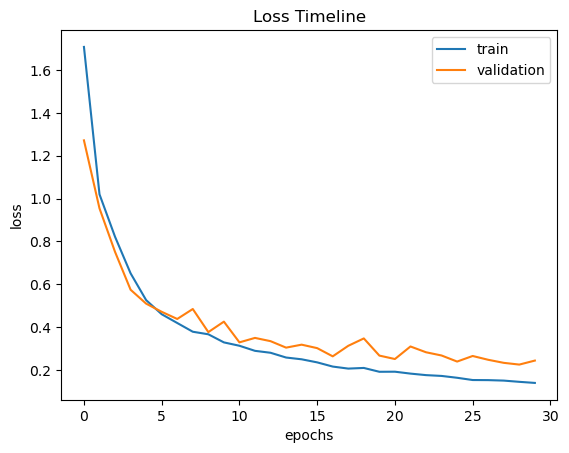

In [52]:
# plotting loss timeline
plt.plot(train_val_model.history["loss"])
plt.plot(train_val_model.history["val_loss"])
plt.ylabel("loss")
plt.xlabel("epochs")
plt.title("Loss Timeline")
plt.legend(["train", "validation"], loc="upper right")
plt.show()

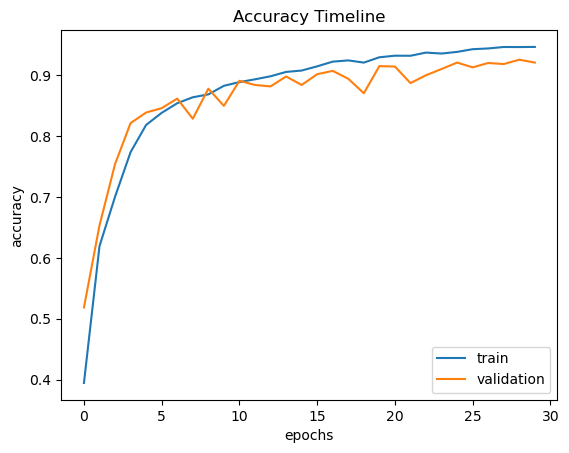

In [53]:
# plotting accuracy timeline
plt.plot(train_val_model.history["accuracy"])
plt.plot(train_val_model.history["val_accuracy"])
plt.ylabel("accuracy")
plt.xlabel("epochs")
plt.title("Accuracy Timeline")
plt.legend(["train", "validation"], loc="lower right")
plt.show()

In [54]:
print("Evaluating test data")
model.evaluate(test_data)

Evaluating test data
92/92 [==============================] - 2s 27ms/step - loss: 0.2321 - accuracy: 0.9145


[0.23212644457817078, 0.9145386219024658]

The model evaluation on test data shows that if this model were to classify images it has not seen before, it will still produce satisfactory results of 91.45% accuracy. 